# Use GDELT dataset to predict Event types based series of features
Expected event types to be any of the following:
1. Verbal Cooperation
2. Material Cooperation
3. Verbal Conflict
4. Material Conflict

In [1]:
import pandas as pd 
from utils import transform_data, int_to_datetime, get_null_values

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

## 1. Load data and transform

In [2]:
data = pd.read_csv("230722.csv")

column_names = [
    'GlobalEventID',
    'Day',
    'MonthYear',
    'Year',
    'FractionDate',
    'Actor1Code',
    'Actor1Name',
    'Actor1CountryCode',
    'Actor1KnownGroupCode',
    'Actor1EthnicCode',
    'Actor1Religion1Code',
    'Actor1Religion2Code',
    'Actor1Type1Code',
    'Actor1Type2Code',
    'Actor1Type3Code',
    'Actor2Code',
    'Actor2Name',
    'Actor2CountryCode',
    'Actor2KnownGroupCode',
    'Actor2EthnicCode',
    'Actor2Religion1Code',
    'Actor2Religion2Code',
    'Actor2Type1Code',
    'Actor2Type2Code',
    'Actor2Type3Code',
    'IsRootEvent',
    'EventCode',
    'EventBaseCode',
    'EventRootCode',
    'QuadClass',
    'GoldsteinScale',
    'NumMentions',
    'NumSources',
    'NumArticles',
    'AvgTone',
    'Actor1Geo_Type',
    'Actor1Geo_FullName',
    'Actor1Geo_CountryCode',
    'Actor1Geo_ADM1Code',
    'Actor1Geo_Lat',
    'Actor1Geo_Long',
    'Actor1Geo_FeatureID',
    'Actor2Geo_Type',
    'Actor2Geo_FullName',
    'Actor2Geo_CountryCode',
    'Actor2Geo_ADM1Code',
    'Actor2Geo_Lat',
    'Actor2Geo_Long',
    'Actor2Geo_FeatureID',
    'DateAdded',
    'SourceURL'
        ]

data = transform_data(data, column_names)

data = int_to_datetime(data, "day")
data = int_to_datetime(data, "dateadded")

# Let use small segment of the dataset
data_sm = data[data['year']==2022]

data_lm = data[data['year']!=2022]

# columns = data_sm.columns.tolist()
# columns.remove('quadclass')
# columns.append('quadclass')

# data_sm = data_sm[columns]

data_lm.head()

,globaleventid,day,monthyear,year,fractiondate,actor1code,actor1name,actor1countrycode,actor1knowngroupcode,actor1ethniccode,actor1religion1code,actor1religion2code,actor1type1code,actor1type2code,actor1type3code,actor2code,actor2name,actor2countrycode,actor2knowngroupcode,actor2ethniccode,actor2religion1code,actor2religion2code,actor2type1code,actor2type2code,actor2type3code,isrootevent,eventcode,eventbasecode,eventrootcode,quadclass,goldsteinscale,nummentions,numsources,numarticles,avgtone,actor1geo_type,actor1geo_fullname,actor1geo_countrycode,actor1geo_adm1code,actor1geo_lat,actor1geo_long,actor1geo_featureid,actor2geo_type,actor2geo_fullname,actor2geo_countrycode,actor2geo_adm1code,actor2geo_lat,actor2geo_long,actor2geo_featureid,dateadded,sourceurl
13,1116435795,2023-06-22,202306,2023,2023.4712,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BUS,COMPANY,NaN,NaN,NaN,NaN,NaN,BUS,NaN,NaN,0,40,40,4,Verbal Cooperation,1.0,5,1,5,1.118963,0,NaN,NaN,NaN,NaN,NaN,NaN,3,"Fort Smith, Arkansas, United States",US,USAR,35.3859,-94.3985,76952,2023-07-22,https://www.kuaf.com/show/ozarks-at-large/2023...
14,1116435796,2023-06-22,202306,2023,2023.4712,AFR,AFRICA,AFR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,43,43,4,Verbal Cooperation,2.8,4,1,4,0.790514,1,Russia,RS,RS,60.0000,100.0000,RS,1,Russia,RS,RS,60.0000,100.0000,RS,2023-07-22,https://www.beijingbulletin.com/news/273906652...
15,1116435797,2023-06-22,202306,2023,2023.4712,AFR,AFRICA,AFR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RUS,RUSSIAN,RUS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,43,43,4,Verbal Cooperation,2.8,10,3,10,-0.491013,4,"Pretoria, Gauteng, South Africa",SF,SF06,-25.7069,28.2294,-1273769,4,"Pretoria, Gauteng, South Africa",SF,SF06,-25.7069,28.2294,-1273769,2023-07-22,https://www.beijingbulletin.com/news/273906652...
16,1116435798,2023-06-22,202306,2023,2023.4712,AFR,AFRICA,AFR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RUS,RUSSIAN,RUS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,43,43,4,Verbal Cooperation,2.8,2,1,2,0.790514,1,Russia,RS,RS,60.0000,100.0000,RS,1,Russia,RS,RS,60.0000,100.0000,RS,2023-07-22,https://www.beijingbulletin.com/news/273906652...
17,1116435799,2023-06-22,202306,2023,2023.4712,AFR,AFRICA,AFR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RUSGOV,RUSSIAN,RUS,NaN,NaN,NaN,NaN,GOV,NaN,NaN,1,43,43,4,Verbal Cooperation,2.8,18,3,18,-0.491013,4,"Pretoria, Gauteng, South Africa",SF,SF06,-25.7069,28.2294,-1273769,4,"Pretoria, Gauteng, South Africa",SF,SF06,-25.7069,28.2294,-1273769,2023-07-22,https://www.beijingbulletin.com/news/273906652...


## 2. Identify Total number of NULL of each feature 

In [3]:
get_null_values(data_lm)

actor2type3code          87517
actor1type3code          87517
actor2religion2code      87351
actor1religion2code      87289
actor2ethniccode         87168
actor1ethniccode         87011
actor2knowngroupcode     86724
actor1knowngroupcode     86627
actor2religion1code      86621
actor1religion1code      86523
actor2type2code          86025
actor1type2code          85240
actor2type1code          58516
actor1type1code          50638
actor2countrycode        48626
actor1countrycode        37956
actor2code               25351
actor2name               25351
actor1geo_fullname       11051
actor1geo_long           11051
actor1geo_lat            11051
actor1geo_featureid      11044
actor1geo_adm1code       11044
actor1geo_countrycode    11044
actor1name                8630
actor1code                8630
actor2geo_lat             2723
actor2geo_fullname        2723
actor2geo_long            2723
actor2geo_adm1code        2718
actor2geo_countrycode     2718
actor2geo_featureid       2718
actor2ge

## 3. Selection of features that seem importanace 
quadclass is the target and rest of the attributes are the feature. And I am trying to predict type of events.

In [4]:
new_data = data_lm[
[      'fractiondate',
       'year',
       'monthyear',
       'actor1code', 
        'actor1name', 
        'actor1geo_type',
        'actor1geo_long',
        'actor1geo_lat',
        'actor2code', 
        'actor2name', 
        'actor2geo_type',
        'actor2geo_long',
        'actor2geo_lat',
        'isrootevent',
        'eventcode',
        'eventrootcode',
        'goldsteinscale',
        'nummentions',
        'numsources',
        'avgtone',
        'quadclass'
  ]
]


new_data.head() 

,fractiondate,year,monthyear,actor1code,actor1name,actor1geo_type,actor1geo_long,actor1geo_lat,actor2code,actor2name,actor2geo_type,actor2geo_long,actor2geo_lat,isrootevent,eventcode,eventrootcode,goldsteinscale,nummentions,numsources,avgtone,quadclass
13,2023.4712,2023,202306,NaN,NaN,0,NaN,NaN,BUS,COMPANY,3,-94.3985,35.3859,0,40,4,1.0,5,1,1.118963,Verbal Cooperation
14,2023.4712,2023,202306,AFR,AFRICA,1,100.0000,60.0000,NaN,NaN,1,100.0000,60.0000,1,43,4,2.8,4,1,0.790514,Verbal Cooperation
15,2023.4712,2023,202306,AFR,AFRICA,4,28.2294,-25.7069,RUS,RUSSIAN,4,28.2294,-25.7069,1,43,4,2.8,10,3,-0.491013,Verbal Cooperation
16,2023.4712,2023,202306,AFR,AFRICA,1,100.0000,60.0000,RUS,RUSSIAN,1,100.0000,60.0000,0,43,4,2.8,2,1,0.790514,Verbal Cooperation
17,2023.4712,2023,202306,AFR,AFRICA,4,28.2294,-25.7069,RUSGOV,RUSSIAN,4,28.2294,-25.7069,1,43,4,2.8,18,3,-0.491013,Verbal Cooperation


## 4. Set Classifcation Experiment (MultiClass)
This function initializes the training environment and creates the transformation pipeline.

In [5]:
from pycaret.classification import ClassificationExperiment

cls_exp = ClassificationExperiment()

cls_exp.setup(data=new_data,
      target='quadclass', 
      session_id=123,
      log_experiment='mlflow', experiment_name='gdelt_experiment')

,Description,Value
0,Session id,123
1,Target,quadclass
2,Target type,Multiclass
3,Target mapping,"Material Conflict: 0, Material Cooperation: 1, Verbal Conflict: 2, Verbal Cooperation: 3"
4,Original data shape,"(87552, 21)"
5,Transformed data shape,"(87552, 31)"
6,Transformed train set shape,"(61286, 31)"
7,Transformed test set shape,"(26266, 31)"
8,Ordinal features,1
9,Numeric features,13


2023/08/16 03:15:16 WARNING mlflow.utils.git_utils: Failed to import Git (the Git executable is probably not on your PATH), so Git SHA is not available. Error: Failed to initialize: Bad git executable.
The git executable must be specified in one of the following ways:
    - be included in your $PATH
    - be set via $GIT_PYTHON_GIT_EXECUTABLE
    - explicitly set via git.refresh()

All git commands will error until this is rectified.

This initial warning can be silenced or aggravated in the future by setting the
$GIT_PYTHON_REFRESH environment variable. Use one of the following values:
    - quiet|q|silence|s|none|n|0: for no warning or exception
    - warn|w|warning|1: for a printed warning
    - error|e|raise|r|2: for a raised exception

Example:
    export GIT_PYTHON_REFRESH=quiet



## 5. Compare Models
This function trains and evaluates the performance of all the estimators available in the model library using cross-validation.

In [6]:
best = cls_exp.compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
dt,Decision Tree Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2530
rf,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.3150
gbc,Gradient Boosting Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.3320
et,Extra Trees Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.3340
xgboost,Extreme Gradient Boosting,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2430
lightgbm,Light Gradient Boosting Machine,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.3330
catboost,CatBoost Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2730
knn,K Neighbors Classifier,0.9886,0.9985,0.9886,0.9885,0.9885,0.9803,0.9803,1.5500
lda,Linear Discriminant Analysis,0.9741,0.9979,0.9741,0.9766,0.9734,0.9554,0.9562,0.2390
nb,Naive Bayes,0.9392,0.9888,0.9392,0.9397,0.9339,0.8936,0.8960,0.2320


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [7]:
# start mlflow server on localhost:500
# !mlflow ui

## 6. Analyze Model

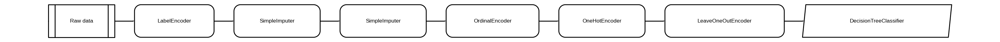

In [8]:
cls_exp.evaluate_model(best)

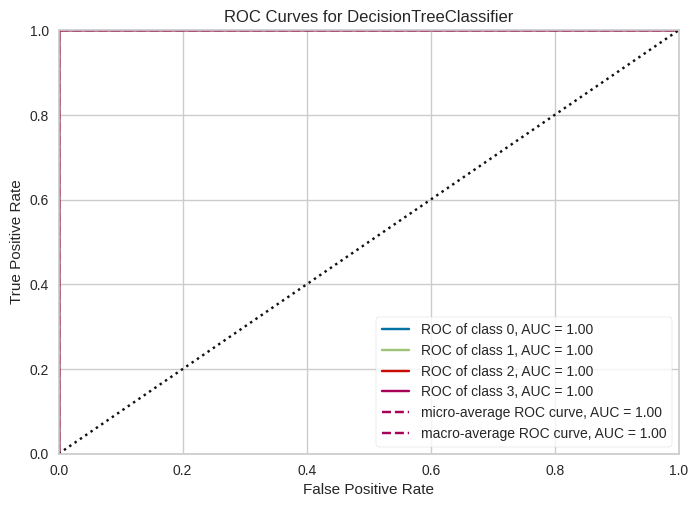

In [9]:
cls_exp.plot_model(best, plot = 'auc')

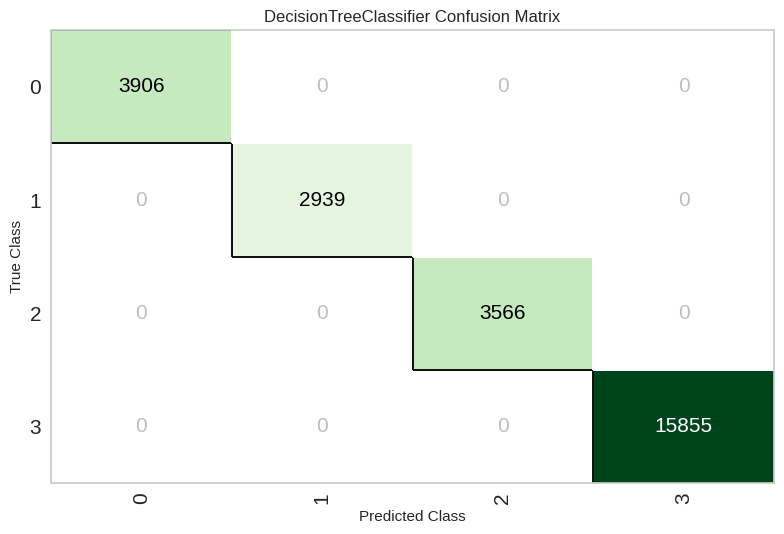

In [10]:

cls_exp.plot_model(best, plot = 'confusion_matrix')

## 7.Prediction
The predict_model function returns prediction_label and prediction_score

In [11]:
cls_exp.predict_model(best)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Decision Tree Classifier,1.0000,1.0000,0,0,0,1.0000,1.0000


,fractiondate,year,monthyear,actor1code,actor1name,actor1geo_type,actor1geo_long,actor1geo_lat,actor2code,actor2name,...,isrootevent,eventcode,eventrootcode,goldsteinscale,nummentions,numsources,avgtone,quadclass,prediction_label,prediction_score
31450,2023.553345,2023,202307,MIL,ADMIRAL,0,NaN,NaN,NaN,NaN,...,1,141,14,-6.5,10,1,0.342466,Verbal Conflict,Verbal Conflict,1.0
48897,2023.553345,2023,202307,GBR,UNITED KINGDOM,4,9.283330,46.000000,EDU,SCHOOL,...,0,42,4,1.9,2,1,-1.656566,Verbal Cooperation,Verbal Cooperation,1.0
12834,2023.553345,2023,202307,USAGOV,UNITED STATES,3,-97.108101,32.735699,USA,UNITED STATES,...,1,173,17,-5.0,3,1,-11.538462,Material Conflict,Material Conflict,1.0
44679,2023.553345,2023,202307,USAEDU,LOUISVILLE,1,-98.579498,39.828175,USA,THE US,...,1,43,4,2.8,4,1,3.697617,Verbal Cooperation,Verbal Cooperation,1.0
85615,2023.553345,2023,202307,RUS,RUSSIA,4,80.366699,55.733299,MED,JOURNALIST,...,0,190,19,-10.0,2,1,-6.853932,Material Conflict,Material Conflict,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27292,2023.553345,2023,202307,PAK,PAKISTAN,4,67.050003,24.866699,LEG,CONGRESS,...,0,46,4,7.0,1,1,-3.353293,Verbal Cooperation,Verbal Cooperation,1.0
11539,2023.553345,2023,202307,NaN,NaN,0,NaN,NaN,GOV,FIREFIGHTER,...,1,190,19,-10.0,4,1,-2.671756,Material Conflict,Material Conflict,1.0
49950,2023.553345,2023,202307,MYS,MALAYSIA,4,101.750000,2.693100,NaN,NaN,...,0,160,16,-4.0,10,1,-2.588997,Material Conflict,Material Conflict,1.0
47478,2023.553345,2023,202307,USA,UNITED STATES,3,-81.782600,24.555700,NaN,NaN,...,1,43,4,2.8,38,3,3.366935,Verbal Cooperation,Verbal Cooperation,1.0


In [12]:
# Predict model on new data 
data_sm_new = data_sm[
[      'fractiondate',
       'year',
       'monthyear',
       'actor1code', 
        'actor1name', 
        'actor1geo_type',
        'actor1geo_long',
        'actor1geo_lat',
        'actor2code', 
        'actor2name', 
        'actor2geo_type',
        'actor2geo_long',
        'actor2geo_lat',
        'isrootevent',
        'eventcode',
        'eventrootcode',
        'goldsteinscale',
        'nummentions',
        'numsources',
        'avgtone'
  ]
]

predictions = cls_exp.predict_model(best, data= data_sm_new)
predictions.head()

,fractiondate,year,monthyear,actor1code,actor1name,actor1geo_type,actor1geo_long,actor1geo_lat,actor2code,actor2name,...,actor2geo_lat,isrootevent,eventcode,eventrootcode,goldsteinscale,nummentions,numsources,avgtone,prediction_label,prediction_score
0,2022.553345,2022,202207,CAN,CANADA,4,-137.817001,66.849998,CHRCTH,CATHOLIC,...,66.849998,1,20,2,3.0,13,2,-3.829401,Verbal Cooperation,1.0
1,2022.553345,2022,202207,CAN,CANADA,4,-137.817001,66.849998,CHRCTH,CATHOLIC,...,66.849998,1,90,9,-2.0,13,2,-3.829401,Material Cooperation,1.0
2,2022.553345,2022,202207,CVL,COMMUNITY,4,-137.817001,66.849998,CHRCTH,CATHOLIC,...,66.849998,1,20,2,3.0,7,2,-3.829401,Verbal Cooperation,1.0
3,2022.553345,2022,202207,CVL,COMMUNITY,4,-137.817001,66.849998,CHRCTH,CATHOLIC,...,66.849998,1,90,9,-2.0,7,2,-3.829401,Material Cooperation,1.0
4,2022.553345,2022,202207,EDU,STUDENT,3,-77.649696,39.083401,NaN,NaN,...,39.083401,0,110,11,-2.0,10,1,0.393701,Verbal Conflict,1.0


## 8. Save Pipeline
Finally, save the entire pipeline on disk for later use, using pycaret's save_model function.

In [13]:
# save pipeline
cls_exp.save_model(best, 'prototype_pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=/tmp/joblib),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['fractiondate', 'year',
                                              'monthyear', 'actor1geo_long',
                                              'actor1geo_lat', 'actor2geo_long',
                                              'actor2geo_lat', 'eventcode',
                                              'eventrootcode', '...
                                                                    handle_unknown='value',
                                                                    random_state=123,
                                                                    return_df=True,
                                   

## 9. Load pipeline

In [14]:
loaded_best_pipeline = cls_exp.load_model('prototype_pipeline')
loaded_best_pipeline

Transformation Pipeline and Model Successfully Loaded


Pipeline(memory=FastMemory(location=/tmp/joblib),
         steps=[('label_encoding',
                 TransformerWrapperWithInverse(exclude=None, include=None,
                                               transformer=LabelEncoder())),
                ('numerical_imputer',
                 TransformerWrapper(exclude=None,
                                    include=['fractiondate', 'year',
                                             'monthyear', 'actor1geo_long',
                                             'actor1geo_lat', 'actor2geo_long',
                                             'actor2geo_lat', 'eventcode',
                                             'eventrootcode', '...
                                                                   handle_unknown='value',
                                                                   random_state=123,
                                                                   return_df=True,
                                                                   sigma=None,
                                                                   verbose=0))),
                ('trained_model',
                 DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                        criterion='gini', max_depth=None,
                                        max_features=None, max_leaf_nodes=None,
                                        min_impurity_decrease=0.0,
                                        min_samples_leaf=1, min_samples_split=2,
                                        min_weight_fraction_leaf=0.0,
                                        random_state=123, splitter='best'))],
         verbose=False)

### Change the seed

In [15]:
cls_exp.set_config('seed', 786)

# Optional - Pycaret Function Overview

### Initialize Setup function 
This function initializes the experiment in PyCaret and creates the transformation pipeline based on all the parameters passed in the function. Setup function must be called before executing any other function

In [16]:
cls_exp2 = ClassificationExperiment()

cls_exp2.setup(data=new_data,
                         target='quadclass',
                         session_id=123,
                         normalize = True, normalize_method = 'minmax')

,Description,Value
0,Session id,123
1,Target,quadclass
2,Target type,Multiclass
3,Target mapping,"Material Conflict: 0, Material Cooperation: 1, Verbal Conflict: 2, Verbal Cooperation: 3"
4,Original data shape,"(87552, 21)"
5,Transformed data shape,"(87552, 31)"
6,Transformed train set shape,"(61286, 31)"
7,Transformed test set shape,"(26266, 31)"
8,Ordinal features,1
9,Numeric features,13


#### Check all available config
Use `get_config` method to access all the variables created by the setup function such as transformed dataset, random_state, etc.

In [17]:
cls_exp2.get_config()

{'USI',
 'X',
 'X_test',
 'X_test_transformed',
 'X_train',
 'X_train_transformed',
 'X_transformed',
 '_available_plots',
 '_ml_usecase',
 'data',
 'dataset',
 'dataset_transformed',
 'exp_id',
 'exp_name_log',
 'fix_imbalance',
 'fold_generator',
 'fold_groups_param',
 'fold_shuffle_param',
 'gpu_n_jobs_param',
 'gpu_param',
 'html_param',
 'idx',
 'is_multiclass',
 'log_plots_param',
 'logging_param',
 'memory',
 'n_jobs_param',
 'pipeline',
 'seed',
 'target_param',
 'test',
 'test_transformed',
 'train',
 'train_transformed',
 'variable_and_property_keys',
 'variables',
 'y',
 'y_test',
 'y_test_transformed',
 'y_train',
 'y_train_transformed',
 'y_transformed'}

#### Access X_train_transformed 

In [18]:
cls_exp2.get_config('X_train_transformed')

,fractiondate,year,monthyear,actor1code,actor1name,actor1geo_type_1.0,actor1geo_type_3.0,actor1geo_type_0.0,actor1geo_type_4.0,actor1geo_type_2.0,...,actor2geo_type_5.0,actor2geo_long,actor2geo_lat,isrootevent,eventcode,eventrootcode,goldsteinscale,nummentions,numsources,avgtone
81443,1.0,1.0,1.0,0.824561,0.822222,1.0,0.0,0.0,0.0,0.0,...,0.0,0.219505,0.766707,1.0,0.022515,0.210526,0.670,0.002768,0.000000,0.598545
56767,1.0,1.0,1.0,0.747514,0.761102,0.0,1.0,0.0,0.0,0.0,...,0.0,0.536042,0.780694,1.0,0.017573,0.157895,0.595,0.000000,0.000000,0.385306
12544,1.0,1.0,1.0,0.596752,0.646251,1.0,0.0,0.0,0.0,0.0,...,0.0,0.603010,0.864029,1.0,0.098847,0.947368,0.000,0.003384,0.002725,0.328698
28447,1.0,1.0,1.0,0.747537,0.761130,0.0,0.0,1.0,0.0,0.0,...,0.0,0.491317,0.843848,0.0,0.049423,0.473684,0.250,0.002768,0.000000,0.377341
11546,1.0,1.0,1.0,0.747514,0.761102,0.0,0.0,1.0,0.0,0.0,...,0.0,0.219747,0.703121,1.0,0.017573,0.157895,0.595,0.015072,0.010899,0.448734
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36885,1.0,1.0,1.0,0.773630,0.870206,0.0,0.0,0.0,0.0,1.0,...,0.0,0.287284,0.769677,0.0,0.088962,0.842105,0.250,0.000615,0.000000,0.472580
27048,1.0,1.0,1.0,0.773407,0.849943,0.0,0.0,0.0,1.0,0.0,...,0.0,0.506652,0.562731,0.0,0.006590,0.052632,0.660,0.000308,0.000000,0.545891
83204,1.0,1.0,1.0,0.741314,0.647940,0.0,0.0,0.0,0.0,0.0,...,1.0,0.507649,0.563527,1.0,0.012630,0.105263,0.760,0.000615,0.000000,0.483439
68620,1.0,1.0,1.0,0.766871,0.702842,1.0,0.0,0.0,0.0,0.0,...,0.0,0.553407,0.841097,0.0,0.022515,0.210526,0.670,0.002768,0.000000,0.336228


#### Check the X_train_transformed to see effect of params passed

<AxesSubplot: >

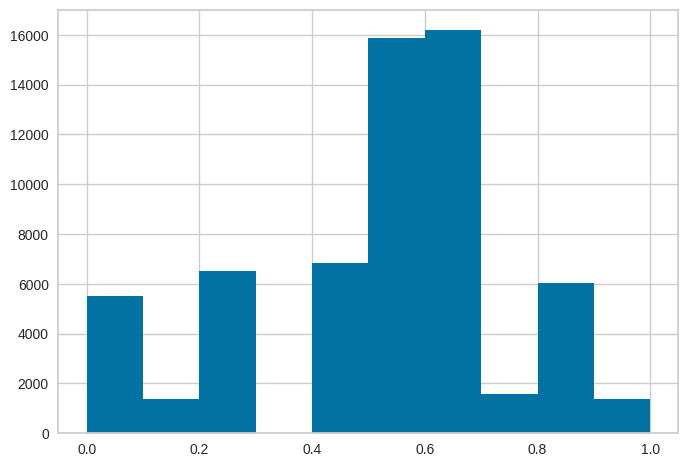

In [19]:
cls_exp2.get_config('X_train_transformed')['goldsteinscale'].hist()

#### Access seed

In [20]:
cls_exp2.get_config('seed')

123

#### Check available models 

In [21]:
# help(cls_exp2.setup)

cls_exp2.models()

### Compare Models
This function trains and evaluates the performance of all estimators available in the model library using cross-validation. The output of this function is a scoring grid with average cross-validated scores. Metrics evaluated during CV can be accessed using the get_metrics function. Custom metrics can be added or removed using `add_metric` and `remove_metric` function.

In [22]:
best = cls_exp2.compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
dt,Decision Tree Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2190
rf,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2580
gbc,Gradient Boosting Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2880
et,Extra Trees Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.3050
xgboost,Extreme Gradient Boosting,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2150
lightgbm,Light Gradient Boosting Machine,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2620
catboost,CatBoost Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2200
lr,Logistic Regression,0.9937,1.0000,0.9937,0.9939,0.9937,0.9892,0.9892,0.1980
knn,K Neighbors Classifier,0.9753,0.9968,0.9753,0.9754,0.9750,0.9575,0.9577,1.4990
lda,Linear Discriminant Analysis,0.9741,0.9979,0.9741,0.9766,0.9734,0.9554,0.9562,0.1890


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

You can use the include and exclude parameter in the compare_models to train only select model or exclude specific models from training by passing the model id's in exclude parameter.

In [23]:
compare_tree_models = cls_exp2.compare_models(include=['lr', 'knn', 'rf', 'xgboost'])

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2620
xgboost,Extreme Gradient Boosting,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2180
lr,Logistic Regression,0.9937,1.0000,0.9937,0.9939,0.9937,0.9892,0.9892,0.1970
knn,K Neighbors Classifier,0.9753,0.9968,0.9753,0.9754,0.9750,0.9575,0.9577,1.5260


Processing:   0%|          | 0/21 [00:00<?, ?it/s]

The function above has return trained model object as an output. The scoring grid is only displayed and not returned. If you need access to the scoring grid you can use `pull` function to access the dataframe.

In [24]:
compare_tree_models_results = cls_exp2.pull()
compare_tree_models_results

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.262
xgboost,Extreme Gradient Boosting,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.218
lr,Logistic Regression,0.9937,1.0000,0.9937,0.9939,0.9937,0.9892,0.9892,0.197
knn,K Neighbors Classifier,0.9753,0.9968,0.9753,0.9754,0.9750,0.9575,0.9577,1.526


By default compare_models return the single best performing model based on the metric defined in the sort parameter.

In [25]:
best_recall_models_top3 = cls_exp2.compare_models(sort='Recall', n_select= 3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
dt,Decision Tree Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2140
rf,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2620
gbc,Gradient Boosting Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2920
et,Extra Trees Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.3130
xgboost,Extreme Gradient Boosting,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2210
lightgbm,Light Gradient Boosting Machine,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2720
catboost,CatBoost Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.2250
lr,Logistic Regression,0.9937,1.0000,0.9937,0.9939,0.9937,0.9892,0.9892,0.2030
knn,K Neighbors Classifier,0.9753,0.9968,0.9753,0.9754,0.9750,0.9575,0.9577,1.5200
lda,Linear Discriminant Analysis,0.9741,0.9979,0.9741,0.9766,0.9734,0.9554,0.9562,0.1970


Processing:   0%|          | 0/71 [00:00<?, ?it/s]

In [26]:
best_recall_models_top3

[DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                        max_depth=None, max_features=None, max_leaf_nodes=None,
                        min_impurity_decrease=0.0, min_samples_leaf=1,
                        min_samples_split=2, min_weight_fraction_leaf=0.0,
                        random_state=123, splitter='best'),
 RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                        criterion='gini', max_depth=None, max_features='sqrt',
                        max_leaf_nodes=None, max_samples=None,
                        min_impurity_decrease=0.0, min_samples_leaf=1,
                        min_samples_split=2, min_weight_fraction_leaf=0.0,
                        n_estimators=100, n_jobs=-1, oob_score=False,
                        random_state=123, verbose=0, warm_start=False),
 GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                            learning_rate=0.1, loss='l

Some other parameters that you might find very useful in compare_models are:

* fold
* cross_validation
* budget_time
* errors
* probability_threshold
* parallel 

You can check the docstring of the function for more info.

### Check available metrics used in CV

In [27]:
cls_exp2.get_metrics()

,Name,Display Name,Score Function,Scorer,Target,Args,Greater is Better,Multiclass,Custom
ID,,,,,,,,,
acc,Accuracy,Accuracy,<function accuracy_score at 0x7fffae49e700>,accuracy,pred,{},True,True,False
auc,AUC,AUC,<pycaret.internal.metrics.BinaryMulticlassScor...,"make_scorer(roc_auc_score, needs_proba=True, e...",pred_proba,"{'average': 'weighted', 'multi_class': 'ovr'}",True,True,False
recall,Recall,Recall,<pycaret.internal.metrics.BinaryMulticlassScor...,"make_scorer(recall_score, average=weighted, po...",pred,"{'average': 'weighted', 'pos_label': 'Verbal C...",True,True,False
precision,Precision,Prec.,<pycaret.internal.metrics.BinaryMulticlassScor...,"make_scorer(precision_score, average=weighted,...",pred,"{'average': 'weighted', 'pos_label': 'Verbal C...",True,True,False
f1,F1,F1,<pycaret.internal.metrics.BinaryMulticlassScor...,"make_scorer(f1_score, average=weighted, pos_la...",pred,"{'average': 'weighted', 'pos_label': 'Verbal C...",True,True,False
kappa,Kappa,Kappa,<function cohen_kappa_score at 0x7fffae49e820>,make_scorer(cohen_kappa_score),pred,{},True,True,False
mcc,MCC,MCC,<function matthews_corrcoef at 0x7fffae49e940>,make_scorer(matthews_corrcoef),pred,{},True,True,False


#### Create a custom metric function

In [28]:
import numpy as np

def custom_metric(y, y_pred):
    tp = np.where((y_pred==1) & (y==1), (100), 0)
    fp = np.where((y_pred==1) & (y==0), -5, 0)
    return np.sum([tp,fp])

# add metric to PyCaret
cls_exp2.add_metric('custom_metric', 'Custom Metric', custom_metric)

Name                                              Custom Metric
Display Name                                      Custom Metric
Score Function       <function custom_metric at 0x7fff785dfdc0>
Scorer                               make_scorer(custom_metric)
Target                                                     pred
Args                                                         {}
Greater is Better                                          True
Multiclass                                                 True
Custom                                                     True
Name: custom_metric, dtype: object

In [29]:
cls_exp2.compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Custom Metric,TT (Sec)
dt,Decision Tree Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0000,0.2190
rf,Random Forest Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0000,0.2660
gbc,Gradient Boosting Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0000,0.2940
et,Extra Trees Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0000,0.2800
xgboost,Extreme Gradient Boosting,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0000,0.2040
lightgbm,Light Gradient Boosting Machine,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0000,0.2670
catboost,CatBoost Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0000,0.2270
lr,Logistic Regression,0.9937,1.0000,0.9937,0.9939,0.9937,0.9892,0.9892,0.0000,0.2060
knn,K Neighbors Classifier,0.9753,0.9968,0.9753,0.9754,0.9750,0.9575,0.9577,0.0000,1.4980
lda,Linear Discriminant Analysis,0.9741,0.9979,0.9741,0.9766,0.9734,0.9554,0.9562,0.0000,0.1930


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=123, splitter='best')

#### Remove Custom metric

In [30]:
cls_exp2.remove_metric('custom_metric')

### Create models

#### Train logistic regression with default fold=10

In [31]:
# train logistic regression with default fold=10
lr = cls_exp2.create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9927,1.0000,0.9927,0.9929,0.9926,0.9874,0.9875
1,0.9933,1.0000,0.9933,0.9934,0.9933,0.9885,0.9885
2,0.9946,1.0000,0.9946,0.9947,0.9946,0.9908,0.9908
3,0.9927,1.0000,0.9927,0.9929,0.9926,0.9874,0.9875
4,0.9925,1.0000,0.9925,0.9927,0.9924,0.9871,0.9872
5,0.9928,1.0000,0.9928,0.9931,0.9928,0.9877,0.9877
6,0.9954,1.0000,0.9954,0.9955,0.9954,0.9922,0.9922
7,0.9941,1.0000,0.9941,0.9943,0.9941,0.9899,0.9900
8,0.9931,1.0000,0.9931,0.9933,0.9931,0.9882,0.9883


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

The function above has return trained model object as an output. The scoring grid is only displayed and not returned. If you need access to the scoring grid you can use `pull` function to access the dataframe.

In [32]:
lr_results = cls_exp2.pull()
lr_results

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9927,1.0,0.9927,0.9929,0.9926,0.9874,0.9875
1,0.9933,1.0,0.9933,0.9934,0.9933,0.9885,0.9885
2,0.9946,1.0,0.9946,0.9947,0.9946,0.9908,0.9908
3,0.9927,1.0,0.9927,0.9929,0.9926,0.9874,0.9875
4,0.9925,1.0,0.9925,0.9927,0.9924,0.9871,0.9872
5,0.9928,1.0,0.9928,0.9931,0.9928,0.9877,0.9877
6,0.9954,1.0,0.9954,0.9955,0.9954,0.9922,0.9922
7,0.9941,1.0,0.9941,0.9943,0.9941,0.9899,0.9900
8,0.9931,1.0,0.9931,0.9933,0.9931,0.9882,0.9883


In [33]:
# train logistic regression with fold 3
lr = cls_exp2.create_model('lr', fold=3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9867,0.9999,0.9867,0.9875,0.9866,0.9772,0.9774
1,0.9855,0.9999,0.9855,0.9867,0.9853,0.9751,0.9754
2,0.9878,1.0000,0.9878,0.9885,0.9877,0.9791,0.9793
Mean,0.9867,1.0000,0.9867,0.9876,0.9865,0.9771,0.9774
Std,0.0009,0.0000,0.0009,0.0008,0.0010,0.0016,0.0016


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

#### Train lr and return train score as well alongwith CV

In [34]:
cls_exp2.create_model('lr', return_train_score=True)

Processing:   0%|          | 0/4 [00:00<?, ?it/s]

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=123, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [35]:
# change the probability threshold of classifier from 0.5 to 0.66
# cls_exp2.create_model('lr', probability_threshold=0.66)

Some other parameters that you might find very useful in create_model are:

* cross_validation
* engine
* fit_kwargs
* groups

#### Train a dt model with default params

In [36]:
dt = cls_exp2.create_model('dt')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

### Tune Model
This function tunes the hyperparameters of the model. The output of this function is a scoring grid with cross-validated scores by fold. The best model is selected based on the metric defined in optimize parameter. Metrics evaluated during cross-validation can be accessed using the get_metrics function. 

In [37]:
tune = cls_exp2.tune_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


#### Define tuning grid

In [38]:
# define tuning grid
dt_grid = {'max_depth' : [None, 2, 4, 6, 8, 10, 12]}

# tune model with custom grid and metric = F1
tuned_dt = cls_exp2.tune_model(dt, custom_grid = dt_grid, optimize = 'F1')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 7 candidates, totalling 70 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


#### Tune dt using optuna

In [39]:
tuned_dt = cls_exp2.tune_model(dt, search_library = 'optuna')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

[I 2023-08-16 03:20:25,448] Searching the best hyperparameters using 61286 samples...
[I 2023-08-16 03:21:52,510] Finished hyperparemeter search!


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


For more details on all available search_library and search_algorithm please check the docstring. Some other parameters that you might find very useful in tune_model are:

* choose_better
* n_iter
* early_stopping
* groups

## Ensemble Model 
This function ensembles a given estimator. The output of this function is a scoring grid with CV scores by fold. Metrics evaluated during CV can be accessed using the get_metrics function.

#### Ensemble with bagging

In [40]:
# ensemble with bagging
cls_exp2.ensemble_model(dt, method = 'Bagging')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/6 [00:00<?, ?it/s]

BaggingClassifier(base_estimator='deprecated', bootstrap=True,
                  bootstrap_features=False,
                  estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                   class_weight=None,
                                                   criterion='gini',
                                                   max_depth=None,
                                                   max_features=None,
                                                   max_leaf_nodes=None,
                                                   min_impurity_decrease=0.0,
                                                   min_samples_leaf=1,
                                                   min_samples_split=2,
                                                   min_weight_fraction_leaf=0.0,
                                                   random_state=123,
                                                   splitter='best'),
                  max_features=1.0, max_samples=1.0, n_estimators=10,
                  n_jobs=None, oob_score=False, random_state=123, verbose=0,
                  warm_start=False)

Some other parameters that you might find very useful in ensemble_model are:

* choose_better
* n_estimators
* groups
* fit_kwargs
* probability_threshold
* return_train_score

### Blend Models 
This function trains a Soft Voting / Majority Rule classifier for select models passed in the estimator_list parameter. The output of this function is a scoring grid with CV scores by fold. Metrics evaluated during CV can be accessed using the get_metrics function. 

In [41]:
# top 3 models based on recall
best_recall_models_top3

[DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                        max_depth=None, max_features=None, max_leaf_nodes=None,
                        min_impurity_decrease=0.0, min_samples_leaf=1,
                        min_samples_split=2, min_weight_fraction_leaf=0.0,
                        random_state=123, splitter='best'),
 RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                        criterion='gini', max_depth=None, max_features='sqrt',
                        max_leaf_nodes=None, max_samples=None,
                        min_impurity_decrease=0.0, min_samples_leaf=1,
                        min_samples_split=2, min_weight_fraction_leaf=0.0,
                        n_estimators=100, n_jobs=-1, oob_score=False,
                        random_state=123, verbose=0, warm_start=False),
 GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                            learning_rate=0.1, loss='l

In [42]:
cls_exp2.blend_models(best_recall_models_top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/6 [00:00<?, ?it/s]

VotingClassifier(estimators=[('Decision Tree Classifier',
                              DecisionTreeClassifier(ccp_alpha=0.0,
                                                     class_weight=None,
                                                     criterion='gini',
                                                     max_depth=None,
                                                     max_features=None,
                                                     max_leaf_nodes=None,
                                                     min_impurity_decrease=0.0,
                                                     min_samples_leaf=1,
                                                     min_samples_split=2,
                                                     min_weight_fraction_leaf=0.0,
                                                     random_state=123,
                                                     splitter='best')),
                             ('Random Forest Classifier',
                              RandomForestCla...
                                                         max_depth=3,
                                                         max_features=None,
                                                         max_leaf_nodes=None,
                                                         min_impurity_decrease=0.0,
                                                         min_samples_leaf=1,
                                                         min_samples_split=2,
                                                         min_weight_fraction_leaf=0.0,
                                                         n_estimators=100,
                                                         n_iter_no_change=None,
                                                         random_state=123,
                                                         subsample=1.0,
                                                         tol=0.0001,
                                                         validation_fraction=0.1,
                                                         verbose=0,
                                                         warm_start=False))],
                 flatten_transform=True, n_jobs=-1, verbose=False,
                 voting='soft', weights=None)

Some other parameters that you might find very useful in blend_models are:

* choose_better
* method
* weights
* fit_kwargs
* probability_threshold
* return_train_score

### Stack Models
This function trains a meta-model over select estimators passed in the estimator_list parameter. The output of this function is a scoring grid with CV scores by fold. Metrics evaluated during CV can be accessed using the get_metrics function. 

In [43]:
# stack models
cls_exp2.stack_models(best_recall_models_top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/6 [00:00<?, ?it/s]

StackingClassifier(cv=5,
                   estimators=[('Decision Tree Classifier',
                                DecisionTreeClassifier(ccp_alpha=0.0,
                                                       class_weight=None,
                                                       criterion='gini',
                                                       max_depth=None,
                                                       max_features=None,
                                                       max_leaf_nodes=None,
                                                       min_impurity_decrease=0.0,
                                                       min_samples_leaf=1,
                                                       min_samples_split=2,
                                                       min_weight_fraction_leaf=0.0,
                                                       random_state=123,
                                                       splitter='best')),
                               ('Random Forest Classifier',
                                RandomFo...
                                                           validation_fraction=0.1,
                                                           verbose=0,
                                                           warm_start=False))],
                   final_estimator=LogisticRegression(C=1.0, class_weight=None,
                                                      dual=False,
                                                      fit_intercept=True,
                                                      intercept_scaling=1,
                                                      l1_ratio=None,
                                                      max_iter=1000,
                                                      multi_class='auto',
                                                      n_jobs=None, penalty='l2',
                                                      random_state=123,
                                                      solver='lbfgs',
                                                      tol=0.0001, verbose=0,
                                                      warm_start=False),
                   n_jobs=-1, passthrough=False, stack_method='auto',
                   verbose=0)

ome other parameters that you might find very useful in stack_models are:

* choose_better
* meta_model
* method
* restack
* probability_threshold
* return_train_score

### Plot Model
This function analyzes the performance of a trained model on the hold-out set. It may require re-training the model in certain cases.

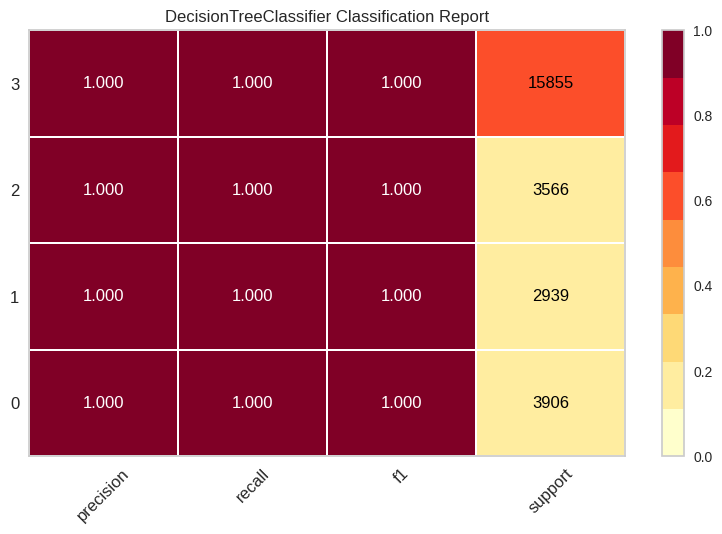

In [44]:
cls_exp2.plot_model(best, plot='class_report')

In [45]:
cls_exp2.plot_model(best, plot='class_report', save=True)

'Class Report.png'

Some other parameters that you might find very useful in plot_model are:

* fit_kwargs
* plot_kwargs
* groups
* display_format

### Interpret Model
This function analyzes the predictions generated from a trained model. Most plots in this function are implemented based on the SHAP (Shapley Additive exPlanations). 

In [46]:
# train lightgbm model
lightgbm = cls_exp2.create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

#### interpret summary model

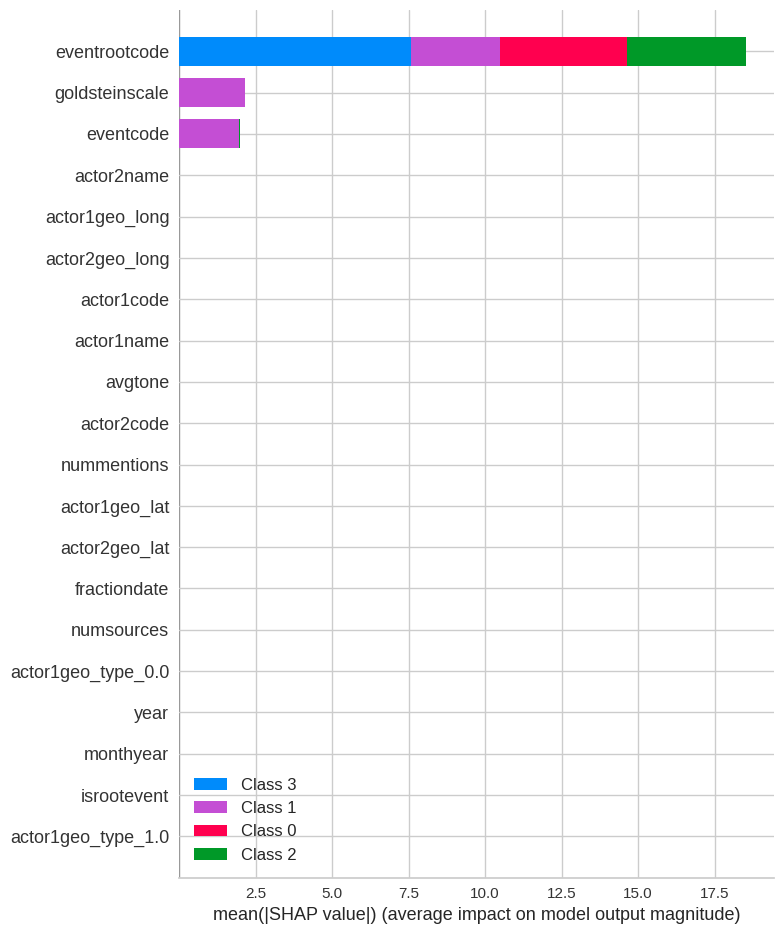

In [47]:

cls_exp2.interpret_model(lightgbm, plot = 'summary')

#### Reason plot for test set observation 1

In [48]:
cls_exp2.interpret_model(lightgbm, plot = 'reason', observation = 1)

Some other parameters that you might find very useful in interpret_model are:

* plot
* feature
* use_train_data
* X_new_sample
* y_new_sample
* save


### Calbrate Model
This function calibrates the probability of a given model using isotonic or logistic regression. The output of this function is a scoring grid with CV scores by fold.

#### Check calbiration of default dt

In [49]:
# cls_exp2.plot_model(dt, plot = 'calibration')

#### Calibrate default dt

In [50]:

calibrated_dt = cls_exp2.calibrate_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Processing:   0%|          | 0/6 [00:00<?, ?it/s]

#### Check calbiration of calibrated dt

In [51]:
# cls_exp2.plot_model(calibrated_dt, plot = 'calibration')

Some other parameters that you might find very useful in calibrate_model are:

* calibrate_fold
* fit_kwargs
* method
* return_train_score
* groups


### Leaderboard
This function returns the leaderboard of all models trained in the current setup.

In [52]:
lb = cls_exp2.get_leaderboard()
lb

Processing:   0%|          | 0/68 [00:00<?, ?it/s]

,Model Name,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,Custom Metric
Index,,,,,,,,,,
0,Logistic Regression,"(TransformerWrapperWithInverse(exclude=None, i...",0.9937,1.0000,0.9937,0.9939,0.9937,0.9892,0.9892,NaN
1,K Neighbors Classifier,"(TransformerWrapperWithInverse(exclude=None, i...",0.9753,0.9968,0.9753,0.9754,0.9750,0.9575,0.9577,NaN
2,Naive Bayes,"(TransformerWrapperWithInverse(exclude=None, i...",0.9380,0.9844,0.9380,0.9388,0.9326,0.8917,0.8942,NaN
3,Decision Tree Classifier,"(TransformerWrapperWithInverse(exclude=None, i...",1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,NaN
4,SVM - Linear Kernel,"(TransformerWrapperWithInverse(exclude=None, i...",0.9524,0.0000,0.9524,0.9538,0.9512,0.9180,0.9189,NaN
...,...,...,...,...,...,...,...,...,...,...
62,str,"(TransformerWrapperWithInverse(exclude=None, i...",1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,NaN
63,Voting Classifier,"(TransformerWrapperWithInverse(exclude=None, i...",1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,NaN
64,Stacking Classifier,"(TransformerWrapperWithInverse(exclude=None, i...",1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,NaN


### Select the best model based on F1

In [53]:
lb.sort_values(by='F1', ascending=False)['Model'].iloc[0]

Pipeline(memory=FastMemory(location=/tmp/joblib),
         steps=[('label_encoding',
                 TransformerWrapperWithInverse(exclude=None, include=None,
                                               transformer=LabelEncoder())),
                ('numerical_imputer',
                 TransformerWrapper(exclude=None,
                                    include=['fractiondate', 'year',
                                             'monthyear', 'actor1geo_long',
                                             'actor1geo_lat', 'actor2geo_long',
                                             'actor2geo_lat', 'eventcode',
                                             'eventrootcode', '...
                 LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, importance_type='split',
                                learning_rate=0.1, max_depth=-1,
                                min_child_samples=20, min_child_weight=0.001,
                                min_split_gain=0.0, n_estimators=100, n_jobs=-1,
                                num_leaves=31, objective=None, random_state=123,
                                reg_alpha=0.0, reg_lambda=0.0, silent='warn',
                                subsample=1.0, subsample_for_bin=200000,
                                subsample_freq=0)]],
         verbose=False)

### AutoML
This function returns the best model out of all trained models in the current setup based on the optimize parameter.

In [54]:
cls_exp2.automl()

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=123, splitter='best')

### Check Fairness
There are many approaches to conceptualizing fairness. The check_fairness function follows the approach known as group fairness, which asks: which groups of individuals are at risk for experiencing harm. check_fairness provides fairness-related metrics between different groups (also called sub-population).

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Decision Tree Classifier,1.0000,1.0000,0,0,0,1.0000,1.0000


Found 42 subgroups. Evaluation may be slow


,Samples,Accuracy,Recall,Precision,F1,Kappa,MCC,Selection Rate
goldsteinscale,,,,,,,,
-10.0,1693,1.0,1.0,1.0,1.0,NaN,0.0,0.0
-9.5,173,1.0,1.0,1.0,1.0,NaN,0.0,0.0
-9.2,99,1.0,1.0,1.0,1.0,NaN,0.0,0.0
-9.0,386,1.0,1.0,1.0,1.0,NaN,0.0,0.0
-8.0,40,1.0,1.0,1.0,1.0,NaN,0.0,0.0
-7.5,39,1.0,1.0,1.0,1.0,NaN,0.0,0.0
-7.2,101,1.0,1.0,1.0,1.0,NaN,0.0,0.0
-7.0,153,1.0,1.0,1.0,1.0,1.0,1.0,0.0
-6.5,276,1.0,1.0,1.0,1.0,NaN,0.0,0.0


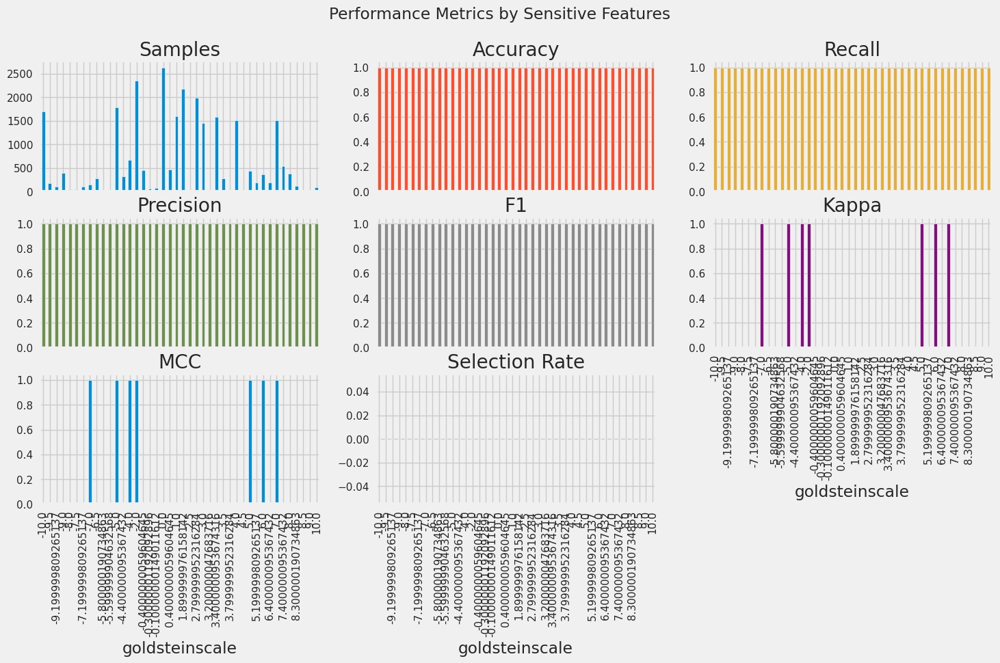

In [61]:
cls_exp2.check_fairness(best, sensitive_features = ['goldsteinscale'])

### Dashboard
he dashboard function generates the interactive dashboard for a trained model. The dashboard is implemented using ExplainerDashboard

In [63]:
# dashboard function
# cls_exp2.dashboard(dt, display_format ='inline')

### Deepcheck
This function runs a full suite check over a trained model using the deepchecks library

In [65]:
# deep check function
# cls_exp2.deep_check(best)

### EDA
This function generates automated Exploratory Data Analysis (EDA) using the AutoViz library. 

In [57]:
cls_exp2.eda()

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine
Shape of your Data Set loaded: (87552, 31)
#######################################################################################
######################## C L A S S

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
avgtone,19394,float64,0,0.000000,22.151407,0,
actor2geo_long,5121,float64,0,0.000000,5.849095,0,
actor1geo_long,4968,float64,0,0.000000,5.674342,0,
actor2geo_lat,4904,float64,0,0.000000,5.601243,0,skewed: cap or drop outliers
actor1geo_lat,4759,float64,0,0.000000,5.435627,0,skewed: cap or drop outliers
actor1name,1242,float64,0,0.000000,1.418586,0,skewed: cap or drop outliers
actor2name,1077,float64,0,0.000000,1.230126,0,skewed: cap or drop outliers
actor1code,804,float64,0,0.000000,0.918311,0,skewed: cap or drop outliers
actor2code,715,float64,0,0.000000,0.816658,0,skewed: cap or drop outliers
nummentions,507,float64,0,0.000000,0.579084,0,highly skewed: drop outliers or do box-cox transform


    30 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Multi_Classification problem #####################
Number of variables = 30 exceeds limit, finding top 30 variables through XGBoost
    No categorical feature reduction done. All 14 Categorical vars selected 
    Removing correlated variables from 16 numerics using SULO method

After removing highly correlated variables, following 11 numeric vars selected: ['actor1code', 'actor1name', 'actor2code', 'actor2name', 'eventcode', 'avgtone', 'eventrootcode', 'actor2geo_long', 'actor2geo_lat', 'fractiondate', 'numsources']
    Adding 14 categorical variables to reduced numeric variables  of 11
############## F E A T U R E   S E L E C T I O N  ####################
Current number of predictors = 25 
    Finding Important Features using Boosted Trees algorithm...
        using 25 variables...
        using 20 variables...
        using 15 variables...
        

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
avgtone,19394,float64,0,0.000000,22.151407,0,
actor2geo_long,5121,float64,0,0.000000,5.849095,0,
actor2geo_lat,4904,float64,0,0.000000,5.601243,0,skewed: cap or drop outliers
actor1name,1242,float64,0,0.000000,1.418586,0,skewed: cap or drop outliers
actor2name,1077,float64,0,0.000000,1.230126,0,skewed: cap or drop outliers
actor1code,804,float64,0,0.000000,0.918311,0,skewed: cap or drop outliers
actor2code,715,float64,0,0.000000,0.816658,0,skewed: cap or drop outliers
eventcode,194,float64,0,0.000000,0.221583,0,highly skewed: drop outliers or do box-cox transform
eventrootcode,20,float64,0,0.000000,0.022844,0,
actor2geo_type_3.0,2,float64,0,0.000000,0.002284,0,skewed: cap or drop outliers


    22 Predictors classified...
    No variables removed since no ID or low-information variables found in data
    List of variables removed: []


Row
    [0] WidgetBox
        [0] Select(name='y', options=['eventrootcode', ...], value='eventrootcode')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['eventcode', ...], value='eventcode')
        [1] Select(name='Y-Axis', options=['eventcode', ...], value='actor2code')
        [2] Select(name='Color', options=['None', 'quadclass'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['actor1geo_type_0.0', ...], value='actor1geo_type_0.0', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['eventrootcode', ...], value='eventrootcode', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

No date vars could be found in data set


HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['actor1geo_type_0.0', ...], value='actor1geo_type_0.0')
        [1] Select(name='Y-Axis', options=['eventcode', ...], value='eventcode')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 35


### Create App
This function creates a basic gradio app for inference.

In [67]:
# create gradio app
# cls_exp2.create_app(best)

### Create API
This function takes an input model and creates a POST API for inference.

In [70]:
# create api
# cls_exp2.create_api(dt, api_name = 'gdelt_api')

### Create Docker 
This function creates a Dockerfile and requirements.txt for productionalizing API end-point.

In [71]:
cls_exp2.create_docker("gdelt_cls_api")

Writing requirements.txt
Writing Dockerfile
Dockerfile and requirements.txt successfully created.
    To build image you have to run --> !docker image build -f "Dockerfile" -t IMAGE_NAME:IMAGE_TAG .
            


### Finalise Model
This function trains a given model on the entire dataset including the hold-out set

In [72]:
final_best = cls_exp2.finalize_model(best)

In [73]:
final_best

Pipeline(memory=FastMemory(location=/tmp/joblib),
         steps=[('label_encoding',
                 TransformerWrapperWithInverse(exclude=None, include=None,
                                               transformer=LabelEncoder())),
                ('numerical_imputer',
                 TransformerWrapper(exclude=None,
                                    include=['fractiondate', 'year',
                                             'monthyear', 'actor1geo_long',
                                             'actor1geo_lat', 'actor2geo_long',
                                             'actor2geo_lat', 'eventcode',
                                             'eventrootcode', '...
                                    transformer=MinMaxScaler(clip=False,
                                                             copy=True,
                                                             feature_range=(0,
                                                                            1)))),
                ('actual_estimator',
                 DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                        criterion='gini', max_depth=None,
                                        max_features=None, max_leaf_nodes=None,
                                        min_impurity_decrease=0.0,
                                        min_samples_leaf=1, min_samples_split=2,
                                        min_weight_fraction_leaf=0.0,
                                        random_state=123, splitter='best'))],
         verbose=False)

### Convert Model
This function transpiles the trained machine learning model's decision function in different programming languages such as Python, C, Java, Go, C#, etc. It is very useful if you want to deploy models into environments where you can't install your normal Python stack to support model inference.

In [75]:
cls_exp2.convert_model(best, language = 'javascript')

'function score(input) {\n    var var0;\n    if (input[25] <= 0.2368421107530594) {\n        var0 = [0.0, 0.0, 0.0, 1.0];\n    } else {\n        if (input[25] <= 0.710526317358017) {\n            if (input[25] <= 0.44736842811107635) {\n                var0 = [0.0, 1.0, 0.0, 0.0];\n            } else {\n                var0 = [0.0, 0.0, 1.0, 0.0];\n            }\n        } else {\n            var0 = [1.0, 0.0, 0.0, 0.0];\n        }\n    }\n    return var0;\n}\n'

### Deploy Model
This function deploys the entire ML pipeline on the cloud.

AWS: When deploying model on AWS S3, environment variables must be configured using the command-line interface. To configure AWS environment variables, type aws configure in terminal. The following information is required which can be generated using the Identity and Access Management (IAM) portal of your amazon console account:

AWS Access Key ID
AWS Secret Key Access
Default Region Name (can be seen under Global settings on your AWS console)
Default output format (must be left blank)
GCP: To deploy a model on Google Cloud Platform ('gcp'), the project must be created using the command-line or GCP console. Once the project is created, you must create a service account and download the service account key as a JSON file to set environment variables in your local environment. Learn more about it: https://cloud.google.com/docs/authentication/production

Azure: To deploy a model on Microsoft Azure ('azure'), environment variables for the connection string must be set in your local environment. Go to settings of storage account on Azure portal to access the connection string required. AZURE_STORAGE_CONNECTION_STRING (required as environment variable) Learn more about it: https://docs.microsoft.com/en-us/azure/storage/blobs/storage-quickstart-blobs-python?toc=%2Fpython%2Fazure%2FTOC.json

In [76]:
# deploy model on aws s3
# cls_exp2.deploy_model(best, model_name = 'my_first_platform_on_aws',
#             platform = 'aws', authentication = {'bucket' : 'pycaret-test'})

In [77]:
# load model from aws s3
# loaded_from_aws = cls_exp2.load_model(model_name = 'my_first_platform_on_aws', platform = 'aws',
#                              authentication = {'bucket' : 'pycaret-test'})

# loaded_from_aws

### Save/Load Model 
This function saves the transformation pipeline and a trained model object into the current working directory as a pickle file for later use.

In [78]:
cls_exp2.save_model(best, 'gdelt_model')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=/tmp/joblib),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['fractiondate', 'year',
                                              'monthyear', 'actor1geo_long',
                                              'actor1geo_lat', 'actor2geo_long',
                                              'actor2geo_lat', 'eventcode',
                                              'eventrootcode', '...
                                     transformer=MinMaxScaler(clip=False,
                                                              copy=True,
                                                              feature_range=(0,
                                                                      

In [81]:
# load model
loaded_from_disk = cls_exp2.load_model('gdelt_model')
loaded_from_disk

Transformation Pipeline and Model Successfully Loaded


Pipeline(memory=FastMemory(location=/tmp/joblib),
         steps=[('label_encoding',
                 TransformerWrapperWithInverse(exclude=None, include=None,
                                               transformer=LabelEncoder())),
                ('numerical_imputer',
                 TransformerWrapper(exclude=None,
                                    include=['fractiondate', 'year',
                                             'monthyear', 'actor1geo_long',
                                             'actor1geo_lat', 'actor2geo_long',
                                             'actor2geo_lat', 'eventcode',
                                             'eventrootcode', '...
                                    transformer=MinMaxScaler(clip=False,
                                                             copy=True,
                                                             feature_range=(0,
                                                                            1)))),
                ('trained_model',
                 DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                        criterion='gini', max_depth=None,
                                        max_features=None, max_leaf_nodes=None,
                                        min_impurity_decrease=0.0,
                                        min_samples_leaf=1, min_samples_split=2,
                                        min_weight_fraction_leaf=0.0,
                                        random_state=123, splitter='best'))],
         verbose=False)

### Save/Load Experiment
This function saves all the experiment variables on disk, allowing to later resume without rerunning the setup function.

#### Save experiment 

In [83]:
cls_exp2.save_experiment('gdelt_experiment')

In [84]:
#### Load experiment 
exp_from_disk = cls_exp2.load_experiment('gdelt_experiment', data=new_data)

,Description,Value
0,Session id,123
1,Target,quadclass
2,Target type,Multiclass
3,Target mapping,"Material Conflict: 0, Material Cooperation: 1, Verbal Conflict: 2, Verbal Cooperation: 3"
4,Original data shape,"(87552, 21)"
5,Transformed data shape,"(87552, 31)"
6,Transformed train set shape,"(61286, 31)"
7,Transformed test set shape,"(26266, 31)"
8,Ordinal features,1
9,Numeric features,13
